**EDA ANALYSIS**

In [4]:
!pip install kaggle

In [ ]:
from google.colab import files
files.upload() # This will open a file upload dialog

In [6]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [7]:
!kaggle competitions download -c image-matching-challenge-2025

100% 4.84G/4.84G [00:54<00:00, 258MB/s]
100% 4.84G/4.84G [00:54<00:00, 95.0MB/s]


In [9]:
!unzip -q image-matching-challenge-2025.zip -d ./data

In [12]:
import pandas as pd
import numpy as np
import os
import glob
from PIL import Image # Pillow for image manipulation
import matplotlib.pyplot as plt
import seaborn as sns
import cv2 # OpenCV (if you need more advanced image operations)

# Optional: to display images inline in Colab
%matplotlib inline

helper functions

In [21]:
# Helper function to construct full image paths
def get_image_path(row, base_dir='./data/train'): # Adjusted base_dir to be more specific
    if 'dataset' in row and 'image' in row and isinstance(row['dataset'], str) and isinstance(row['image'], str):
        return os.path.join(base_dir, row['dataset'], row['image'])
    else:
        print(f"Warning: Could not construct path for row: {row}")
        return None

# Helper function to display multiple images with titles
def open_image(img_paths, titles, n_cols=3, figsize_per_row=(15, 5)): # Changed 'scenes' to 'titles' for more general use
    if not img_paths:
        print("No image paths provided to open_image.")
        return

    n_images = len(img_paths)
    n_rows = (n_images + n_cols - 1) // n_cols  # Calculate number of rows needed

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(figsize_per_row[0], figsize_per_row[1] * n_rows))
    axes = axes.flatten() # Flatten to easily iterate

    for i, img_path in enumerate(img_paths):
        if i >= len(axes): # Should not happen with correct n_rows calculation, but good check
            break

        current_title = titles[i] if i < len(titles) else "No Title"

        if img_path and os.path.exists(img_path):
            try:
                img_pil = Image.open(img_path).convert("RGB") # Ensure RGB for matplotlib
                axes[i].imshow(img_pil)
                axes[i].set_title(current_title, fontsize=10)
            except Exception as e:
                axes[i].set_title(f"Error loading:\n{os.path.basename(img_path)}\n{e}", fontsize=8, color='red')
                print(f"Error loading {img_path}: {e}")
        else:
            axes[i].set_title(f"Not found or invalid:\n{os.path.basename(str(img_path))}", fontsize=8, color='orange')
            print(f"Image path not found or invalid: {img_path}")

        axes[i].axis("off") # Turn off axis for all subplots

    # Turn off axes for any unused subplots
    for j in range(n_images, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

In [23]:
data_dir = './data/'
train_labels_df = pd.read_csv(os.path.join(data_dir, 'train_labels.csv'))

# Add the 'full_path' column (important for the helper functions)
if 'full_path' not in train_labels_df.columns:
    train_labels_df['full_path'] = train_labels_df.apply(lambda row: get_image_path(row, base_dir=os.path.join(data_dir, 'train')), axis=1)

In [24]:
#train_thresholds_df.head()
train_labels_df.info()
#train_thresholds_df.describe(include='all')
#train_thresholds_df['dataset'].value_counts()
#train_thresholds_df.groupby('dataset')['scene'].nunique()#scenes per dataset
#train_thresholds_df.groupby(['dataset', 'scene'])['image'].count()#images per scene

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1945 entries, 0 to 1944
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   dataset             1945 non-null   object
 1   scene               1945 non-null   object
 2   image               1945 non-null   object
 3   rotation_matrix     1945 non-null   object
 4   translation_vector  1945 non-null   object
 5   full_path           1945 non-null   object
dtypes: object(6)
memory usage: 91.3+ KB


In [25]:
# Function to get full image path
def get_image_path(row, base_dir=os.path.join(data_dir, 'train')):
    # Ensure dataset and image columns exist and are strings
    if 'dataset' in row and 'image' in row and isinstance(row['dataset'], str) and isinstance(row['image'], str):
        return os.path.join(base_dir, row['dataset'], row['image'])
    else:
        # Handle cases where columns might be missing or not strings, or return None
        print(f"Warning: Could not construct path for row: {row}")
        return None

# Get the first row of your DataFrame (as an example)
first_image_info = train_labels_df.iloc[0]

# Construct the full path for this first image
image_path_to_load = get_image_path(first_image_info)

print(f"Attempting to load image from: {image_path_to_load}")

Attempting to load image from: ./data/train/imc2023_haiper/fountain_image_116.png


Image loaded successfully! Shape: (1920, 1440, 3)


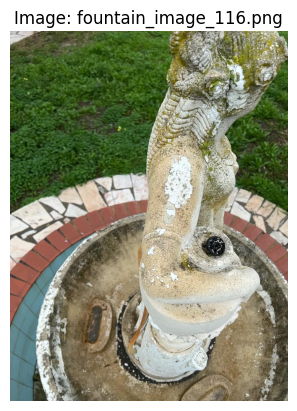

In [26]:
if image_path_to_load and os.path.exists(image_path_to_load): # Check if path is valid and file exists
    # Load the image using OpenCV
    img = cv2.imread(image_path_to_load)

    # Check if the image was loaded successfully
    if img is not None:
        print(f"Image loaded successfully! Shape: {img.shape}") # (height, width, channels)

        # Display the image (using Colab's cv2_imshow for OpenCV images)
        #cv2_imshow(img)

        # Alternatively, using matplotlib (OpenCV loads as BGR, Matplotlib expects RGB)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img_rgb)
        plt.title(f"Image: {first_image_info['image']}")
        plt.axis('off') # Hide axes
        plt.show()
    else:
        print(f"Error: Could not load image from {image_path_to_load}. Check the path and file integrity.")
else:
    if not image_path_to_load:
        print("Error: image_path_to_load was not constructed properly.")
    else:
        print(f"Error: File does not exist at {image_path_to_load}")

Exploring images from Dataset: 'imc2023_haiper', Scene: 'fountain'
Found 23 images in this scene.


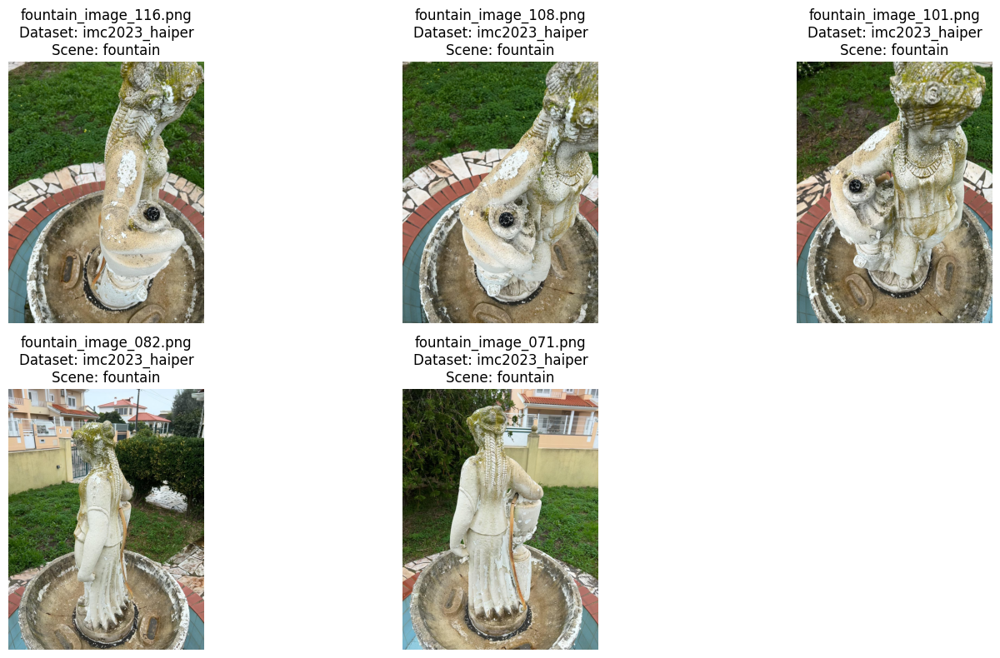

In [27]:
# Identify the dataset and scene of your fountain image
# Let's assume you found it was from 'dataset_X' and 'scene_fountain'
# If you don't know it, find it:
fountain_info = train_labels_df[train_labels_df['image'] == 'fountain_image_116.png'].iloc[0]
current_dataset = fountain_info['dataset']
current_scene = fountain_info['scene']

# For this example, let's hardcode it. **Replace with your actual values!**
#current_dataset = 'heritage-fos-variant Pau Casals' # Example, replace this
#current_scene = 'Pauls Casals Avenue, 23'      # Example, replace this
print(f"Exploring images from Dataset: '{current_dataset}', Scene: '{current_scene}'")

# Filter the DataFrame for images from this specific scene
scene_images_df = train_labels_df[(train_labels_df['dataset'] == current_dataset) &
                                  (train_labels_df['scene'] == current_scene)]

print(f"Found {len(scene_images_df)} images in this scene.")

# Display a few images (e.g., the first 5) from this scene
num_images_to_show = min(5, len(scene_images_df)) # Show up to 5 images

plt.figure(figsize=(15, 5 * num_images_to_show // 3 if num_images_to_show > 2 else 5)) # Adjust figsize
for i in range(num_images_to_show):
    row = scene_images_df.iloc[i]
    img_path = get_image_path(row)

    if img_path and os.path.exists(img_path):
        try:
            # Using PIL and Matplotlib for easier subplotting and RGB display
            img_pil = Image.open(img_path)
            plt.subplot((num_images_to_show + 2) // 3, 3, i + 1) # Arrange in rows of 3
            plt.imshow(img_pil)
            plt.title(f"{row['image']}\nDataset: {row['dataset']}\nScene: {row['scene']}")
            plt.axis('off')
        except Exception as e:
            print(f"Error loading/displaying {img_path}: {e}")
    else:
        print(f"Image path not found or invalid for: {row['image']}")
plt.tight_layout()
plt.show()

images from the same scene:
1.Images from scene [current_scene] in dataset [current_dataset] show minor viewpoint changes."
2.Scale variation seems to be [high/medium/low]."
3.Lighting conditions are [consistent/day/sunny/]."
4.No major occlusions noted "
Overall image quality is [good]."


Exploring images from Dataset: 'imc2023_haiper', Different Scene: 'bike'
Found 15 images in this different scene.


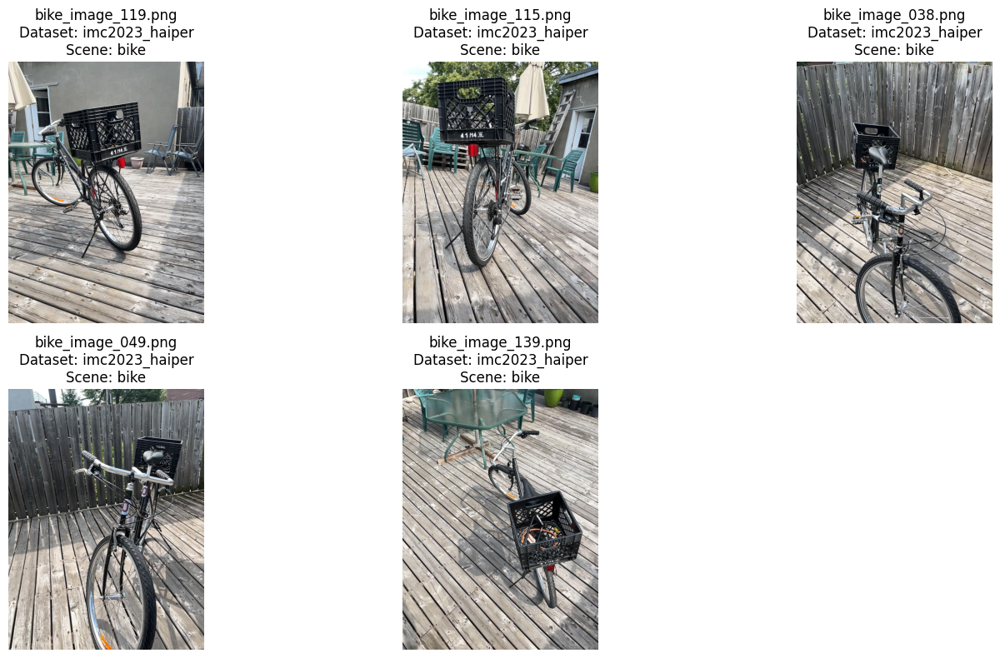

In [28]:
# Find other scenes in the current_dataset
other_scenes_in_dataset = train_labels_df[train_labels_df['dataset'] == current_dataset]['scene'].unique()
# Exclude the current scene if needed, or just pick one that's different
if len(other_scenes_in_dataset) > 1:
    # Pick another scene (e.g., the first one that isn't current_scene, or a specific one if you know its name)
    next_scene_to_explore = None
    for scene_name in other_scenes_in_dataset:
        if scene_name != current_scene:
            next_scene_to_explore = scene_name
            break

    if next_scene_to_explore:
        print(f"\nExploring images from Dataset: '{current_dataset}', Different Scene: '{next_scene_to_explore}'")
        different_scene_images_df = train_labels_df[(train_labels_df['dataset'] == current_dataset) &
                                                    (train_labels_df['scene'] == next_scene_to_explore)]
        print(f"Found {len(different_scene_images_df)} images in this different scene.")

        # Display a few images from this different scene
        num_images_to_show = min(5, len(different_scene_images_df))
        plt.figure(figsize=(15, 5 * num_images_to_show // 3 if num_images_to_show > 2 else 5))
        for i in range(num_images_to_show):
            row = different_scene_images_df.iloc[i]
            img_path = get_image_path(row)
            if img_path and os.path.exists(img_path):
                try:
                    img_pil = Image.open(img_path)
                    plt.subplot((num_images_to_show + 2) // 3, 3, i + 1)
                    plt.imshow(img_pil)
                    plt.title(f"{row['image']}\nDataset: {row['dataset']}\nScene: {row['scene']}")
                    plt.axis('off')
                except Exception as e:
                    print(f"Error loading/displaying {img_path}: {e}")
            else:
                print(f"Image path not found or invalid for: {row['image']}")
        plt.tight_layout()
        plt.show()
    else:
        print(f"Could not find another scene to explore in dataset '{current_dataset}'.")
else:
    print(f"Dataset '{current_dataset}' only has one scene: '{current_scene}'.")

"Scene [bike] in dataset [imc2023_haiper] appears to be [ picture of a bike outside in an outdoor setting]."
"Compared to scene [fountain], it is visually somewhat similar."
"This suggests clustering within this dataset might be [easy].


Exploring images from Different Dataset: 'imc2023_heritage'
Found 61 images in scene 'outliers' of dataset 'imc2023_heritage'.


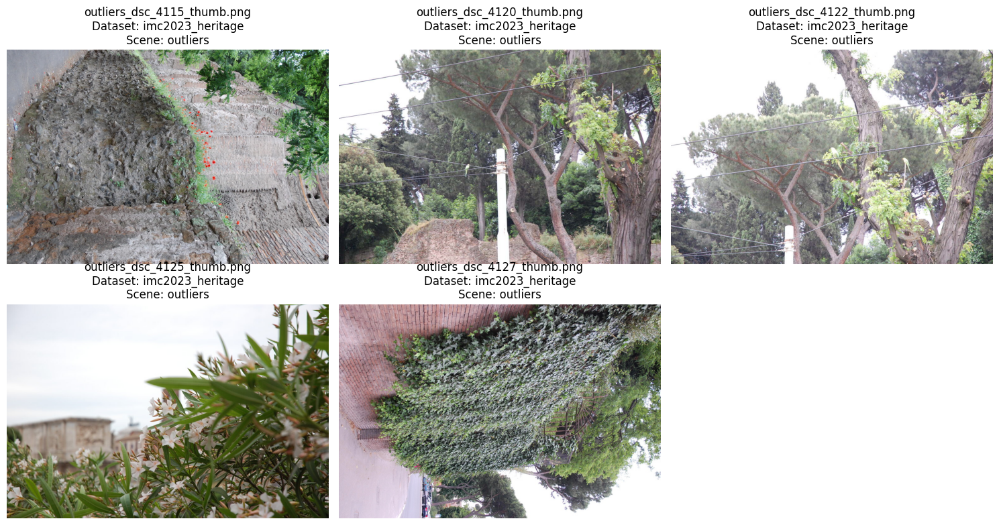

In [29]:
all_datasets = train_labels_df['dataset'].unique()
if len(all_datasets) > 1:
    # Pick a dataset different from current_dataset
    different_dataset_name = None
    for ds_name in all_datasets:
        if ds_name != current_dataset:
            different_dataset_name = ds_name
            break

    if different_dataset_name:
        print(f"\nExploring images from Different Dataset: '{different_dataset_name}'")
        # Get the first scene from this different dataset
        first_scene_in_different_dataset = train_labels_df[train_labels_df['dataset'] == different_dataset_name]['scene'].iloc[0]

        images_from_different_dataset_df = train_labels_df[
            (train_labels_df['dataset'] == different_dataset_name) &
            (train_labels_df['scene'] == first_scene_in_different_dataset)
        ]
        print(f"Found {len(images_from_different_dataset_df)} images in scene '{first_scene_in_different_dataset}' of dataset '{different_dataset_name}'.")

        # Display a few images
        num_images_to_show = min(5, len(images_from_different_dataset_df))
        plt.figure(figsize=(15, 5 * num_images_to_show // 3 if num_images_to_show > 2 else 5))
        for i in range(num_images_to_show):
            row = images_from_different_dataset_df.iloc[i]
            img_path = get_image_path(row) # Assumes default base_dir is correct, or adjust
            if img_path and os.path.exists(img_path):
                try:
                    img_pil = Image.open(img_path)
                    plt.subplot((num_images_to_show + 2) // 3, 3, i + 1)
                    plt.imshow(img_pil)
                    plt.title(f"{row['image']}\nDataset: {row['dataset']}\nScene: {row['scene']}")
                    plt.axis('off')
                except Exception as e:
                    print(f"Error loading/displaying {img_path}: {e}")
            else:
                print(f"Image path not found or invalid for: {row['image']}")
        plt.tight_layout()
        plt.show()
    else:
        print("Could not find another dataset to explore.")
else:
    print("Only one dataset found in train_labels.csv.")

### Observations on Outliers from `imc2023_heritage`:
*   A significant portion of observed outliers (e.g., `outliers_dsc_4115_thumb.png`, `outliers_dsc_4127_thumb.png`) are incorrectly rotated by 90 degrees.
*   Many outliers lack a clear, stable geometric subject, often dominated by:
    *   Foliage (e.g., `outliers_dsc_4122_thumb.png`, close-up `outliers_dsc_4125_thumb.png`).
    *   Sky or generic scenery.
*   Some images seem to be transitional or have out-of-focus primary subjects (e.g., `outliers_dsc_4125_thumb.png` with blurred ruins).
*   **Implications:** Our pipeline may need to consider orientation correction or detection. Outlier detection logic could look for images with low feature match counts or poor geometric consistency with any potential cluster.


Displaying outliers 1 to 15 from 'imc2023_heritage'


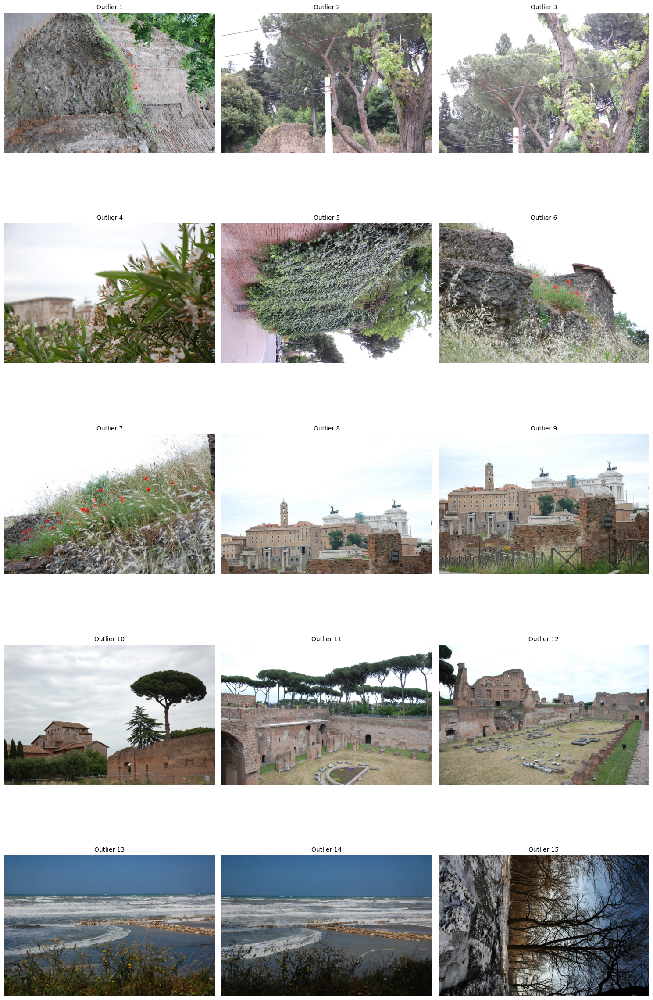


Displaying outliers 16 to 30 from 'imc2023_heritage'


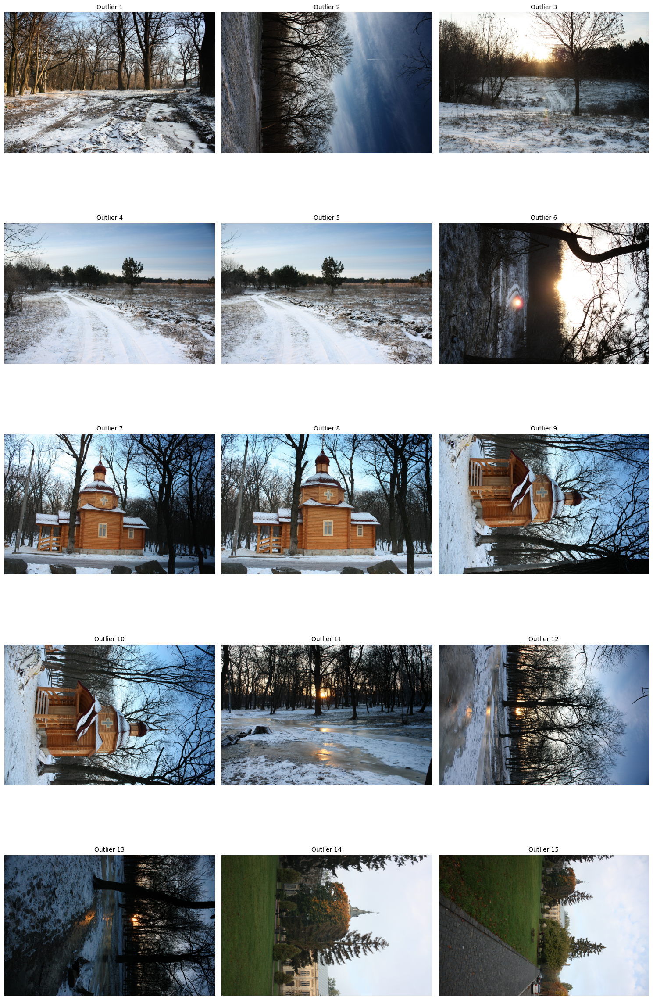


Displaying outliers 31 to 45 from 'imc2023_heritage'


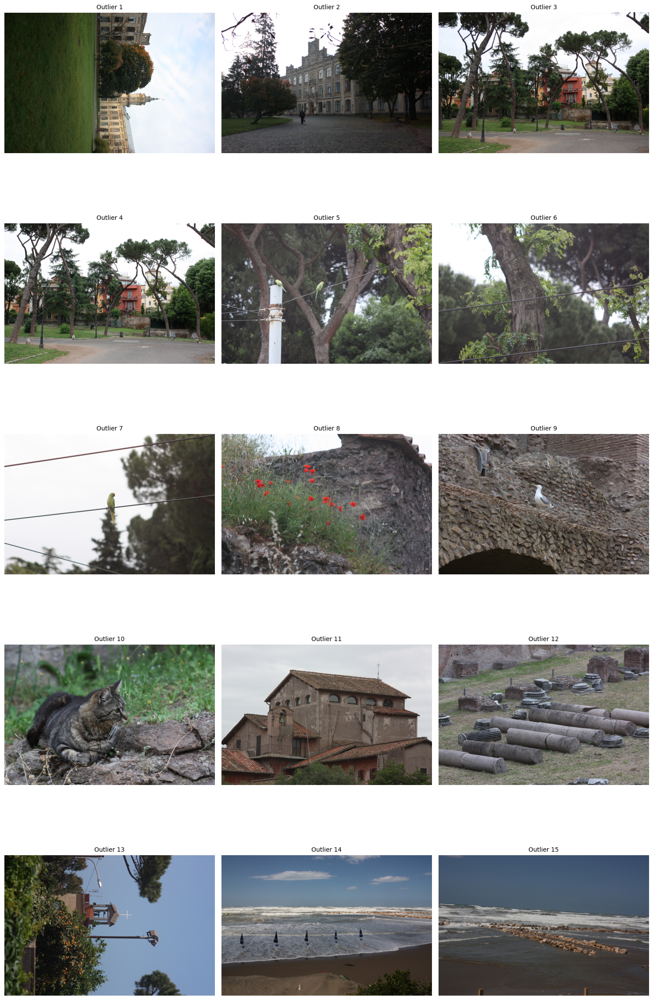


Displaying outliers 46 to 60 from 'imc2023_heritage'


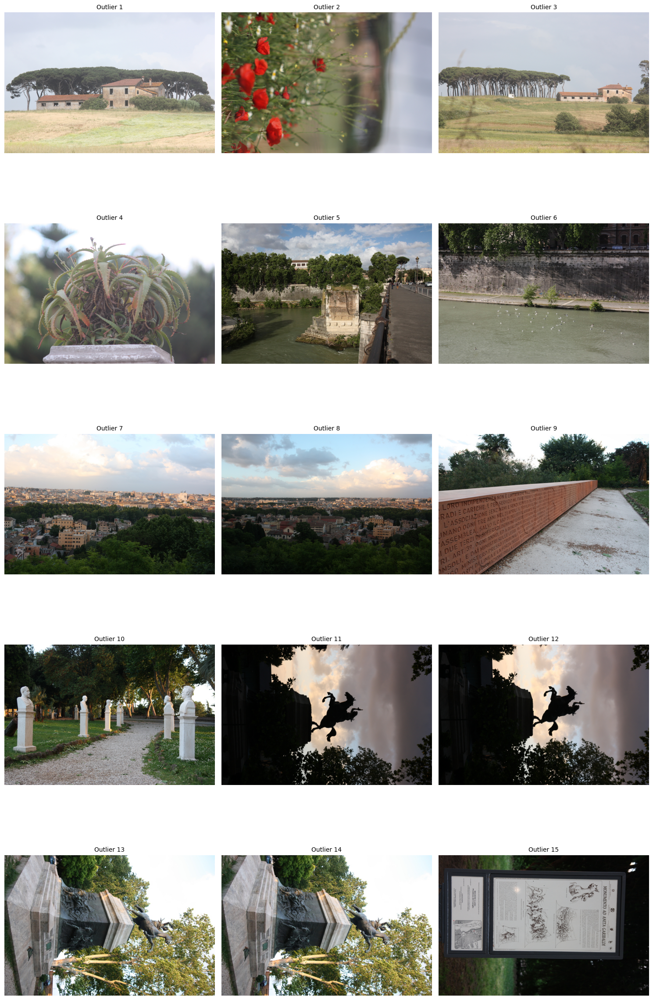


Displaying outliers 61 to 61 from 'imc2023_heritage'


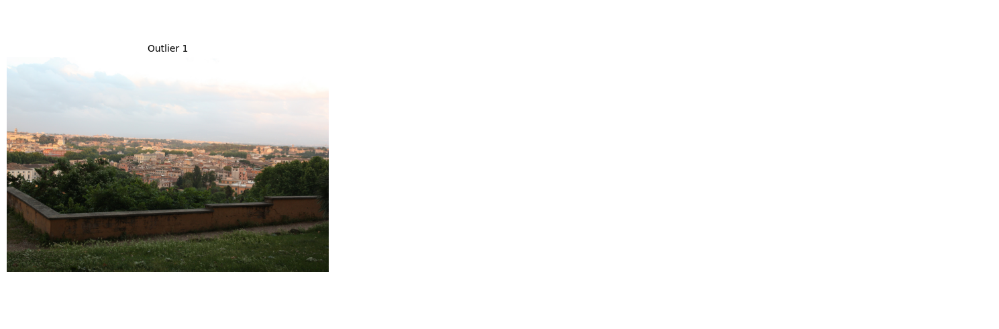

In [30]:
# Assuming 'outlier_images_df' contains the 61 outlier image rows from 'imc2023_heritage'
outlier_images_df = train_labels_df[(train_labels_df['dataset'] == 'imc2023_heritage') &
                                   (train_labels_df['scene'] == 'outliers')]

num_to_display_at_once = 15
total_outliers = len(outlier_images_df)

for batch_start_index in range(0, total_outliers, num_to_display_at_once):
    batch_end_index = min(batch_start_index + num_to_display_at_once, total_outliers)
    current_batch_df = outlier_images_df.iloc[batch_start_index:batch_end_index]

    print(f"\nDisplaying outliers {batch_start_index + 1} to {batch_end_index} from 'imc2023_heritage'")

    image_paths_batch = [get_image_path(row) for _, row in current_batch_df.iterrows()]
    # Use a simplified version of your open_image or matplotlib display loop for this batch
    # For brevity, I'll skip rewriting the full display loop here, but reuse your existing one.
    # Ensure to handle None paths or loading errors.

    # After displaying each batch, pause or add a Markdown cell for notes if doing this interactively.
    # For a script, you'd just log observations.
    open_image(image_paths_batch, [f"Outlier {i+1}" for i in range(len(image_paths_batch))]) # Example

### Further Observations on Outliers from `imc2023_heritage` (Batch of 15)

After reviewing a batch of 15 images labeled as 'outliers' from the `imc2023_heritage` dataset, several distinct characteristics and recurring themes have emerged:

1.  **Dominant Non-Rigid/Out-of-Focus Foreground Elements:**
    *   A significant number of outliers feature plants or flowers as the primary subject, often in extreme close-up (e.g., Outlier 2, Outlier 4). The background elements in these shots are typically minimal or heavily blurred, making them unsuitable for 3D reconstruction.

2.  **Extreme Lighting Conditions & Silhouettes:**
    *   Images with strong backlighting leading to silhouettes (e.g., Outlier 11, Outlier 12, depicting statues against a bright sky) are common. The lack of detail on the subject itself due to shadows makes reliable feature extraction difficult.

3.  **Unusual Angles, Rotations, and "Artistic" Compositions:**
    *   Several images, particularly of statues (Outlier 11-14), are taken from very low angles looking upwards, with the sky dominating much of the frame.
    *   Rotated images are present (e.g., Outlier 15 - information plaque rotated 90 degrees; earlier observations also showed rotated images). These non-standard orientations likely contribute to them being outliers.

4.  **Lack of Clear, Stable Geometric Focus or Predominantly "Nature" Shots:**
    *   Some images are wide landscape views where the primary subject is distant and surrounded by large areas of grass, sky, or generic foliage (e.g., Outlier 1, Outlier 3).
    *   Others are dominated by less structured natural elements like a wide river view with distant, featureless walls (Outlier 6) or distant cityscapes (Outlier 7, 8). These may lack the density of repeatable, close-range features needed for robust SfM.

5.  **Potentially "Reconstructable" but Isolated or Problematic Content:**
    *   Some images appear to show clear structures but may be outliers due to other factors:
        *   **Outlier 9 (Engraved Wall):** Long, repetitive structure might be hard to match uniquely or reconstruct globally.
        *   **Outlier 10 (Path with Busts):** Repetitive elements (busts) and potentially challenging lighting (dappled shadows).
        *   **Outlier 5 (Bridge View):** May be an isolated shot not well-connected to a larger sequence of images forming a scene.

**Implications for Our Pipeline:**

*   **Outlier Detection Strategy:** Our outlier detection will need to be multi-faceted. It could look for:
    *   Images dominated by vegetation (e.g., using image segmentation or a "greenness" heuristic).
    *   Images with extreme exposure or low contrast (characteristic of silhouettes).
    *   Potentially try to detect and correct/flag severely rotated images.
    *   Images that fail to find a significant number of matches with any other images (a common post-matching heuristic for outliers).
*   **Feature Extraction Robustness:** Our chosen feature extractors should ideally be robust to some degree of lighting variation, but extreme cases like silhouettes will likely always be problematic.
*   **Clustering:** Global features for clustering should ideally be less sensitive to "artistic" framing and more focused on the core geometric content of a potential scene.

This analysis provides valuable clues for both identifying outliers and understanding what constitutes a "good" image for successful 3D reconstruction in this dataset.

compare outliers to inliers from same dataset


Examining inlier scene: 'dioscuri' from dataset 'imc2023_heritage'


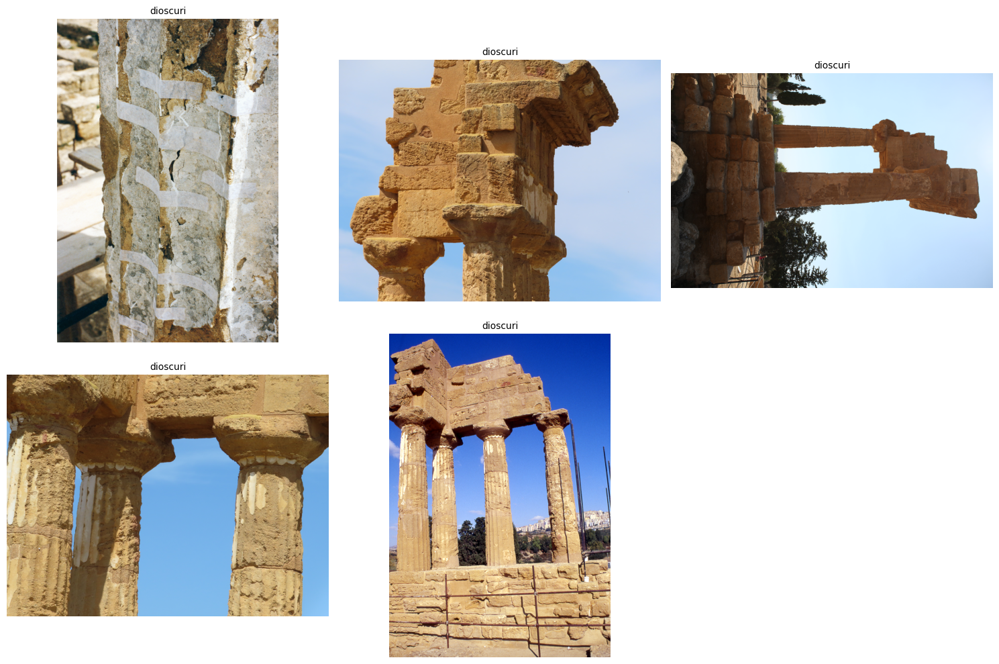

In [32]:
# Find actual scenes in 'imc2023_heritage'
inlier_scenes_heritage = train_labels_df[
    (train_labels_df['dataset'] == 'imc2023_heritage') &
    (train_labels_df['scene'] != 'outliers') # Exclude outliers
]['scene'].unique()

if len(inlier_scenes_heritage) > 0:
    # Pick one inlier scene to examine
    example_inlier_scene_name = inlier_scenes_heritage[0]
    print(f"\nExamining inlier scene: '{example_inlier_scene_name}' from dataset 'imc2023_heritage'")

    inlier_scene_df = train_labels_df[
        (train_labels_df['dataset'] == 'imc2023_heritage') &
        (train_labels_df['scene'] == example_inlier_scene_name)
    ]

    # Display a few images from this inlier scene (reuse your display loop)
    image_paths_inlier_batch = [get_image_path(row) for _, row in inlier_scene_df.head(num_images_to_show).iterrows()]
    open_image(image_paths_inlier_batch, [example_inlier_scene_name]*len(image_paths_inlier_batch) )
else:
    print(f"No 'inlier' scenes found for dataset 'imc2023_heritage' to compare against outliers.")

### Comparing Inliers ("dioscuri" scene) to Outliers in `imc2023_heritage`

To better understand what constitutes a "good" image for scene reconstruction versus an outlier, images from the "dioscuri" scene (dataset `imc2023_heritage`) were compared against previously analyzed outliers from the same dataset.

**Characteristics of "dioscuri" Inlier Images:**
*   **Consistent Subject Focus:** All images clearly depict a specific ancient stone ruin (columns, entablatures), providing a consistent geometric subject.
*   **Rich Texture & Detail:** The weathered stone and architectural elements offer abundant texture suitable for robust local feature matching.
*   **Coherent Viewpoint & Scale Variation:** The scene includes a mix of wider shots and closer views from different angles, all clearly capturing interconnected parts of the same structure. This suggests good overlap for SfM.
*   **Favorable Lighting:** Most images are well-lit with daylight, making features discernible.
*   **Clear Foreground-Background Distinction:** The ruins are well-separated from backgrounds (mostly sky).
*   **Rotation Present:** Notably, one of the inlier images is rotated 90 degrees, similar to some outliers. This suggests that rotation itself isn't an automatic disqualifier if the image content is otherwise strong and part of a reconstructable sequence.

**Key Differences Observed (Inliers vs. Outliers):**
*   **Subject Matter:** Inliers focus on stable, man-made geometry, while outliers often featured dominant non-rigid elements (foliage), lacked a clear subject, or were extreme close-ups of non-structural details.
*   **Lighting & Detail:** Inliers generally had good lighting and detail, whereas many outliers were silhouettes or lacked sufficient texture for matching.
*   **"Photogrammetry Intent":** Inlier images appear taken with the purpose of capturing the structure from useful viewpoints. Outliers often resembled snapshots, artistic shots with challenging compositions (e.g., extreme low angles, sky-dominated), or were simply "bad photos" for reconstruction (e.g., close-ups of flowers, 2D plaques).
*   **Connectivity (Inferred):** Inlier images are presumed to form part of a sequence with good overlap, crucial for SfM. Outliers often seem like isolated images that wouldn't connect well.

**Implications:**
*   Our pipeline needs to identify images centered around consistent, textured, static geometry.
*   While rotation can be present in inliers, it's a common characteristic of images that are outliers for other reasons (e.g., poor subject matter). Our system should ideally be robust to orientation, or we might consider pre-processing for orientation correction.
*   The definition of a "scene" implies a set of images that can be geometrically linked through robust feature matches to reconstruct a coherent 3D structure. Images failing this test are likely outliers.

This comparative analysis reinforces the need for feature extraction methods that capture stable geometric information and for clustering/outlier detection logic that can identify images lacking reconstructable content or coherence with a larger scene.

next step is to Analyze Image Dimensions Across the Entire Training Set

  0%|          | 0/1945 [00:00<?, ?it/s]


Summary Statistics for Image Dimensions:
             width       height  aspect_ratio
count  1945.000000  1945.000000   1945.000000
mean   1101.627763   982.667352      1.117924
std    1046.922140   677.234066      0.400900
min     117.000000   153.000000      0.560951
25%     680.000000   683.000000      0.683594
50%    1024.000000   772.000000      1.333333
75%    1048.000000  1024.000000      1.497076
max    6048.000000  4032.000000      2.343249


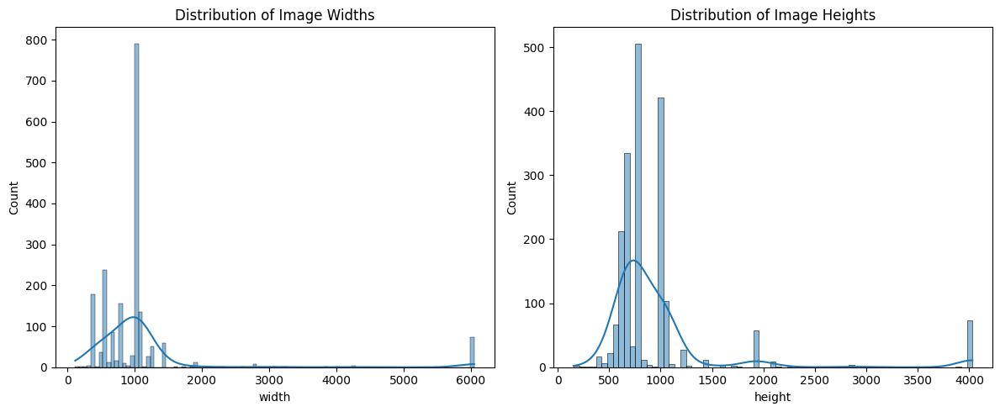

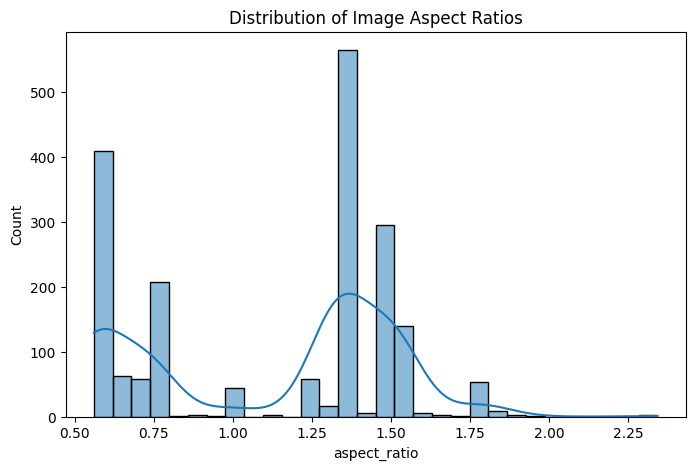

In [33]:
from tqdm.auto import tqdm # For progress bars, !pip install tqdm if needed

image_dimensions = []
# It's more efficient to get unique image paths first if some images appear in multiple contexts
# (though for train_labels, each row should be a unique image instance with a pose)

# Create a 'full_path' column if you haven't already
if 'full_path' not in train_labels_df.columns:
    train_labels_df['full_path'] = train_labels_df.apply(get_image_path, axis=1)

print("\nCollecting image dimensions for all training images...")
# Using unique paths to avoid processing the same file multiple times if it appeared in different contexts
# (though train_labels.csv should have unique image entries for pose)
unique_image_paths = train_labels_df['full_path'].dropna().unique()

for img_path in tqdm(unique_image_paths): # tqdm adds a progress bar
    if img_path and os.path.exists(img_path):
        try:
            with Image.open(img_path) as img_pil:
                width, height = img_pil.size
                image_dimensions.append({'path': img_path, 'width': width, 'height': height, 'aspect_ratio': width/height if height > 0 else 0})
        except Exception as e:
            print(f"Could not open or get dimensions for {img_path}: {e}")
    else:
        print(f"Path does not exist or is None: {img_path}") # Should not happen if full_path is generated correctly

dimensions_df = pd.DataFrame(image_dimensions)

if not dimensions_df.empty:
    print("\nSummary Statistics for Image Dimensions:")
    print(dimensions_df[['width', 'height', 'aspect_ratio']].describe())

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    sns.histplot(dimensions_df['width'], kde=True)
    plt.title('Distribution of Image Widths')

    plt.subplot(1, 2, 2)
    sns.histplot(dimensions_df['height'], kde=True)
    plt.title('Distribution of Image Heights')
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(8, 5))
    sns.histplot(dimensions_df['aspect_ratio'], kde=True, bins=30)
    plt.title('Distribution of Image Aspect Ratios')
    plt.show()
else:
    print("No image dimensions collected.")

### Analysis of Image Dimensions (Training Set)

An analysis of the 1945 unique training images revealed significant variation in their dimensions and aspect ratios.

**Summary Statistics:**
*   **Width:** Mean: ~1102px, Median: 1024px, Min: 117px, Max: 6048px (Std: ~1047px)
*   **Height:** Mean: ~983px, Median: 772px, Min: 153px, Max: 4032px (Std: ~677px)
*   **Aspect Ratio (W/H):** Mean: ~1.12, Median: 1.33 (4:3), Min: ~0.56 (portrait), Max: ~2.34 (panoramic)

**Key Observations from Distributions:**
*   **No Single Standard Size:** Images vary widely.
*   **Widths & Heights:** Show multi-modal distributions, with common peaks around 600-800px and 1000-1050px. A long tail exists for very large images.
*   **Aspect Ratios:** Clear peaks indicate common camera formats:
    *   Strong peak at ~1.33 (4:3 aspect ratio).
    *   Strong peak at ~1.5 (3:2 aspect ratio).
    *   Noticeable peak around 0.66-0.75 (portrait equivalents, e.g., 2:3, 3:4).

**(Include your plots here by taking screenshots and embedding them, or by saving them from Colab and uploading if your Project Hub supports image embedding directly)**

**Implications for Our Pipeline:**
1.  **Mandatory Image Resizing/Padding:** For neural network-based feature extractors (like ViTs) that require fixed-size inputs, a robust preprocessing step is essential. This step must handle varying aspect ratios to avoid distortion.
2.  **Chosen Resizing Strategy:** We will likely need to:
    *   Resize images such that their longest side matches a target dimension (e.g., 224px, 384px, or 512px for ViTs; possibly larger for other feature extractors like ALIKED initially).
    *   Pad the shorter side to achieve the required square or rectangular input shape for the models. The padding method (e.g., zero-padding, reflection padding) needs to be decided.
3.  **Impact on Detail:** Resizing very large images (e.g., 6048px wide) down to typical model input sizes will result in significant detail loss. This is a trade-off to consider, especially for local feature extraction where fine details are important. We may need different strategies for global vs. local feature extraction if this becomes an issue.
4.  **Consistency:** All images fed into a particular model stage must undergo the *exact same* preprocessing steps for consistent feature extraction.

This dimensional analysis highlights the necessity of a carefully designed image preprocessing pipeline as a foundational component before feature extraction.

next step is to analyse other metadata from the csv

In [34]:
# (Continuing from Step 7, assuming unique_image_paths is available)
image_formats = []
image_modes = []
print("\nCollecting image formats and modes...")
for img_path in tqdm(unique_image_paths[:500]): # Process a subset first to check speed
    if img_path and os.path.exists(img_path):
        try:
            with Image.open(img_path) as img_pil:
                image_formats.append(img_pil.format)
                image_modes.append(img_pil.mode)
        except Exception as e:
            print(f"Could not open or get format/mode for {img_path}: {e}")

if image_formats:
    print("\nImage Formats Found:")
    print(pd.Series(image_formats).value_counts())
if image_modes:
    print("\nImage Modes Found:")
    print(pd.Series(image_modes).value_counts())

  0%|          | 0/500 [00:00<?, ?it/s]


Image Formats Found:
PNG    500
Name: count, dtype: int64

Image Modes Found:
RGB    500
Name: count, dtype: int64
